In [2]:
readdir("./data")

8-element Vector{String}:
 "L1L2data.csv"
 "fertilizer.csv"
 "machine1.csv"
 "machine2.csv"
 "machine3.csv"
 "purchaseData.csv"
 "temperatures.csv"
 "weightHeight.csv"

In [3]:
using Pkg
Pkg.activate(".")
Pkg.instantiate()

  Activating environment at `~/ws/JuliaCon2021-StatisticsWithJuliaFromTheGroundUp/Project.toml`
   Installed Lz4_jll ─────────────────── v1.9.3+0
   Installed Blosc ───────────────────── v0.7.0
   Installed URIParser ───────────────── v0.4.1
   Installed Functors ────────────────── v0.2.3
   Installed Intervals ───────────────── v1.5.0
   Installed ForwardDiff ─────────────── v0.10.18
   Installed Plots ───────────────────── v1.19.2
   Installed DataDeps ────────────────── v0.7.7
   Installed ImageMorphology ─────────── v0.2.11
   Installed GPUCompiler ─────────────── v0.12.5
   Installed HDF5_jll ────────────────── v1.12.0+1
   Installed Images ──────────────────── v0.23.3
   Installed Polynomials ─────────────── v2.0.14
   Installed DSP ─────────────────────── v0.7.2
   Installed TimeZones ───────────────── v1.5.6
   Installed Lasso ───────────────────── v0.6.2
   Installed Roots ───────────────────── v1.0.10
   Installed CommonSolve ─────────────── v0.2.0
   Installed Rotations ────

  ✓ ArrayInterface
  ✓ GR
  ✓ Interpolations
  ✓ DiffRules
  ✓ Polynomials
  ✓ FFTViews
  ✓ StatsFuns
  ✓ Blosc
  ✓ EllipsisNotation
  ✓ GPUCompiler
  ✓ Colors
  ✓ DSP
  ✓ StatsModels
  ✓ ForwardDiff
  ✓ IntervalSets
  ✓ HDF5
  ✓ Graphics
  ✓ Widgets
  ✓ Distributions
  ✓ ColorVectorSpace
  ✓ AxisArrays
  ✓ MAT
  ✓ ColorSchemes
  ✓ ImageCore
  ✓ Zygote
  ✓ KernelDensity
  ✓ HypothesisTests
  ✓ GLM
  ✓ MLDatasets
  ✓ ImageMorphology
  ✓ ImageAxes
  ✓ ImageShow
  ✓ ImageTransformations
  ✓ PlotUtils
  ✓ DataFrames
  ✓ ImageDistances
  ✓ Lasso
  ✓ ImageMetadata
  ✓ ImageContrastAdjustment
  ✓ RecipesPipeline
  ✓ RData
  ✓ PlotThemes
  ✓ CUDA
  ✓ RDatasets
  ✓ ImageFiltering
  ✓ NNlibCUDA
  ✓ ImageQualityIndexes
  ✓ Images
  ✓ Flux
  ✓ Metalhead
  ✓ Plots
  ✓ StatsPlots
  101 dependencies successfully precompiled in 229 seconds (156 already precompiled)


In [4]:
Pkg.status()

      Status `~/ws/JuliaCon2021-StatisticsWithJuliaFromTheGroundUp/Project.toml`
  [336ed68f] CSV v0.8.5
  [aaaa29a8] Clustering v0.14.2
  [861a8166] Combinatorics v1.0.2
  [a93c6f00] DataFrames v1.2.0
  [31c24e10] Distributions v0.25.11
  [587475ba] Flux v0.12.5
  [38e38edf] GLM v1.5.1
  [09f84164] HypothesisTests v0.10.4
  [5ab0869b] KernelDensity v0.6.3
  [b964fa9f] LaTeXStrings v1.2.1
  [b4fcebef] Lasso v0.6.2
  [eb30cadb] MLDatasets v0.5.7
  [442fdcdd] Measures v0.3.1
  [dbeba491] Metalhead v0.5.3
  [6f286f6a] MultivariateStats v0.8.0
  [91a5bcdd] Plots v1.19.2
  [ce6b1742] RDatasets v0.7.5
  [f2b01f46] Roots v1.0.10
  [276daf66] SpecialFunctions v1.5.1
  [2913bbd2] StatsBase v0.33.8
  [f3b207a7] StatsPlots v0.14.25


In [7]:
using Random, Statistics, LinearAlgebra, Dates #Shipped with Julia
using Distributions, StatsBase #Core statistics
using CSV, DataFrames #Basic Data
using Plots, StatsPlots, LaTeXStrings, Measures #Plotting and Output
using HypothesisTests, KernelDensity, GLM, Lasso, Clustering, MultivariateStats #Statistical/ML methods
using Flux, Metalhead #Deep learning 
using Combinatorics, SpecialFunctions, Roots #Mathematical misc.
using RDatasets, MLDatasets #Example datasets

In [5]:
fix_seed!() = Random.seed!(0)

fix_seed! (generic function with 1 method)

In [8]:
fix_seed!()
data = rand(Normal(),5)

5-element Vector{Float64}:
  0.6791074260357777
  0.8284134829000359
 -0.3530074003005963
 -0.13485387193052173
  0.5866170746331097

In [9]:
n = length(data)

5

In [10]:
sum(data)/n

0.3212553422675611

In [11]:
+(data...)/n

0.3212553422675611

In [12]:
? +

search: +



```
+(x, y...)
```

Addition operator. `x+y+z+...` calls this function with all arguments, i.e. `+(x, y, z, ...)`.

# Examples

```jldoctest
julia> 1 + 20 + 4
25

julia> +(1, 20, 4)
25
```

---

```
dt::Date + t::Time -> DateTime
```

The addition of a `Date` with a `Time` produces a `DateTime`. The hour, minute, second, and millisecond parts of the `Time` are used along with the year, month, and day of the `Date` to create the new `DateTime`. Non-zero microseconds or nanoseconds in the `Time` type will result in an `InexactError` being thrown.

---

```
bb1 + bb2 -> bb
```

Compute the BoundingBox `bb` that minimally contains `bb1` and `bb2`


In [13]:
"""
This is a function that takes in data and returns its sum.
"""
function my_sum(data)
    s = 0.0
    for d in data
        s += d
    end
    return s
end

my_sum

In [14]:
? my_sum

search: my_sum



This is a function that takes in data and returns its sum.


In [15]:
my_sum(data)/length(data)

0.3212553422675611

In [16]:
mean(data)

0.3212553422675611

In [17]:
data'*ones(n)/n

0.3212553422675611

In [24]:
dot(data,ones(n))/n

0.3212553422675611

In [25]:
? dot

search: dot dotplot dotplot! @__dot__ stdout dropterm DEPOT_PATH groupeddotplot



```
dot(x, y)
x ⋅ y
```

Compute the dot product between two vectors. For complex vectors, the first vector is conjugated.

`dot` also works on arbitrary iterable objects, including arrays of any dimension, as long as `dot` is defined on the elements.

`dot` is semantically equivalent to `sum(dot(vx,vy) for (vx,vy) in zip(x, y))`, with the added restriction that the arguments must have equal lengths.

`x ⋅ y` (where `⋅` can be typed by tab-completing `\cdot` in the REPL) is a synonym for `dot(x, y)`.

# Examples

```jldoctest
julia> dot([1; 1], [2; 3])
5

julia> dot([im; im], [1; 1])
0 - 2im

julia> dot(1:5, 2:6)
70

julia> x = fill(2., (5,5));

julia> y = fill(3., (5,5));

julia> dot(x, y)
150.0
```

---

```
dot(x, A, y)
```

Compute the generalized dot product `dot(x, A*y)` between two vectors `x` and `y`, without storing the intermediate result of `A*y`. As for the two-argument [`dot(_,_)`](@ref), this acts recursively. Moreover, for complex vectors, the first vector is conjugated.

!!! compat "Julia 1.4"
    Three-argument `dot` requires at least Julia 1.4.


# Examples

```jldoctest
julia> dot([1; 1], [1 2; 3 4], [2; 3])
26

julia> dot(1:5, reshape(1:25, 5, 5), 2:6)
4850

julia> ⋅(1:5, reshape(1:25, 5, 5), 2:6) == dot(1:5, reshape(1:25, 5, 5), 2:6)
true
```


In [26]:
mn = 0
for i in 1:length(data)
    global mn = (1/i)*data[i] + (i-1)/i*mn
end
mn

0.32125534226756114

In [27]:
mn = 0
for (i,d) in enumerate(data)
    global mn = (1/i)*d + (i-1)/i*mn #Note that in Jupyter `global` isn't needed here but in the REPL it is.
end
mn

0.32125534226756114

In [28]:
function my_mean(data)
    mn = 0
    for (i,d) in enumerate(data)
        mn = (1/i)*d + (i-1)/i*mn
    end
    return mn
end

my_mean (generic function with 1 method)

In [29]:
my_mean(data)

0.32125534226756114

In [30]:
fix_seed!()
data = rand(Normal(),n) + im*rand(Normal(),n)

5-element Vector{ComplexF64}:
   0.6791074260357777 + 0.29733585084941616im
   0.8284134829000359 + 0.06494754854834232im
  -0.3530074003005963 - 0.10901738508171745im
 -0.13485387193052173 - 0.514210390833322im
   0.5866170746331097 + 1.5743302021369892im

In [31]:
mean(data)

0.3212553422675611 + 0.2626771651239416im

In [32]:
methods(mean)

# 105 methods for generic function "mean":
[1] mean(d::Logistic) in Distributions at /home/banach/.julia/packages/Distributions/fXTVC/src/univariate/continuous/logistic.jl:64
[2] mean(d::EdgeworthZ) in Distributions at /home/banach/.julia/packages/Distributions/fXTVC/src/edgeworth.jl:23
[3] mean(d::InverseGamma{T}) where T in Distributions at /home/banach/.julia/packages/Distributions/fXTVC/src/univariate/continuous/inversegamma.jl:62
[4] mean(M::SubspaceLDA) in MultivariateStats at /home/banach/.julia/packages/MultivariateStats/HTpHt/src/lda.jl:222
[5] mean(M::PCA) in MultivariateStats at /home/banach/.julia/packages/MultivariateStats/HTpHt/src/pca.jl:31
[6] mean(d::Weibull) in Distributions at /home/banach/.julia/packages/Distributions/fXTVC/src/univariate/continuous/weibull.jl:63
[7] mean(d::MatrixFDist) in Distributions at /home/banach/.julia/packages/Distributions/fXTVC/src/matrix/matrixfdist.jl:90
[8] mean(d::MatrixBeta) in Distributions at /home/banach/.julia/packages/Distributions/fXTVC/src/matrix/matrixbeta.jl:84
[9] mean(d::Pareto{T}) where T<:Real in Distributions at /home/banach/.julia/packages/Distributions/fXTVC/src/univariate/continuous/pareto.jl:57
[10] mean(d::FisherNoncentralHypergeometric) in Distributions at /home/banach/.julia/packages/Distributions/fXTVC/src/univariate/discrete/noncentralhypergeometric.jl:209
[11] mean(d::Beta) in Distributions at /home/banach/.julia/packages/Distributions/fXTVC/src/univariate/continuous/beta.jl:63
[12] mean(d::DirichletMultinomial) in Distributions at /home/banach/.julia/packages/Distributions/fXTVC/src/multivariate/dirichletmultinomial.jl:28
[13] mean(d::MatrixNormal) in Distributions at /home/banach/.julia/packages/Distributions/fXTVC/src/matrix/matrixnormal.jl:88
[14] mean(d::Arcsine) in Distributions at /home/banach/.julia/packages/Distributions/fXTVC/src/univariate/continuous/arcsine.jl:64
[15] mean(d::NormalInverseGaussian) in Distributions at /home/banach/.julia/packages/Distributions/fXTVC/src/univariate/continuous/normalinversegaussian.jl:49
[16] mean(d::Epanechnikov) in Distributions at /home/banach/.julia/packages/Distributions/fXTVC/src/univariate/continuous/epanechnikov.jl:38
[17] mean(d::Laplace) in Distributions at /home/banach/.julia/packages/Distributions/fXTVC/src/univariate/continuous/laplace.jl:63
[18] mean(d::UnivariateGMM) in Distributions at /home/banach/.julia/packages/Distributions/fXTVC/src/mixtures/unigmm.jl:26
[19] mean(d::Wishart) in Distributions at /home/banach/.julia/packages/Distributions/fXTVC/src/matrix/wishart.jl:108
[20] mean(d::WalleniusNoncentralHypergeometric) in Distributions at /home/banach/.julia/packages/Distributions/fXTVC/src/univariate/discrete/noncentralhypergeometric.jl:241
[21] mean(r::AbstractRange{var"#s832"} where var"#s832"<:Real) in Statistics at /opt/julias/julia-1.6.2/share/julia/stdlib/v1.6/Statistics/src/Statistics.jl:185
[22] mean(d::BetaBinomial) in Distributions at /home/banach/.julia/packages/Distributions/fXTVC/src/univariate/discrete/betabinomial.jl:56
[23] mean(d::Rayleigh) in Distributions at /home/banach/.julia/packages/Distributions/fXTVC/src/univariate/continuous/rayleigh.jl:55
[24] mean(d::MvNormalCanon) in Distributions at /home/banach/.julia/packages/Distributions/fXTVC/src/multivariate/mvnormalcanon.jl:151
[25] mean(d::TriangularDist) in Distributions at /home/banach/.julia/packages/Distributions/fXTVC/src/univariate/continuous/triangular.jl:65
[26] mean(d::SymTriangularDist) in Distributions at /home/banach/.julia/packages/Distributions/fXTVC/src/univariate/continuous/symtriangular.jl:58
[27] mean(d::Gamma) in Distributions at /home/banach/.julia/packages/Distributions/fXTVC/src/univariate/continuous/gamma.jl:60
[28] mean(f::Whitening) in MultivariateStats at /home/banach/.julia/packages/MultivariateStats/HTpHt/src/whiten.jl:36
[29] mean(f::Function, a::StaticArrays.StaticArray; dims) in StaticArrays at /home/banach/.julia/packages/StaticArrays/AHT47/src/mapreduce.jl:275
[30] mean(d::InverseWishar

In [33]:
@which mean(data)

mean(A::AbstractArray; dims) in Statistics at /opt/julias/julia-1.6.2/share/julia/stdlib/v1.6/Statistics/src/Statistics.jl:164

In [34]:
methods(my_mean)

# 1 method for generic function "my_mean":
[1] my_mean(data) in Main at In[28]:1

In [35]:
function my_mean(data::Vector{Float64})::Float64
    mn = 0.0
    for (i,d) in enumerate(data)
        mn = (1/i)*d + (i-1)/i*mn
    end
    return mn
end

my_mean (generic function with 2 methods)

In [36]:
methods(my_mean)

# 2 methods for generic function "my_mean":
[1] my_mean(data::Vector{Float64}) in Main at In[35]:1
[2] my_mean(data) in Main at In[28]:1

In [37]:
@which my_mean(data)

my_mean(data) in Main at In[28]:1

In [38]:
@which my_mean([1,2])

my_mean(data) in Main at In[28]:1

In [39]:
@which my_mean([1.0,2.0])

my_mean(data::Vector{Float64}) in Main at In[35]:1

In [40]:
@which my_mean([1.0,2])

my_mean(data::Vector{Float64}) in Main at In[35]:1

In [41]:
function my_mean(data::Vector{T})::T where T
    mn = zero(data[begin])
    for (i,d) in enumerate(data)
        mn = (1/i)*d + (i-1)/i*mn
    end
    return mn
end

my_mean (generic function with 3 methods)

In [42]:
methods(my_mean)

# 3 methods for generic function "my_mean":
[1] my_mean(data::Vector{Float64}) in Main at In[35]:1
[2] my_mean(data::Vector{T}) where T in Main at In[41]:1
[3] my_mean(data) in Main at In[28]:1

In [43]:
fix_seed!()
data = [rand(Normal(),2,2) for _ in 1:5]

5-element Vector{Matrix{Float64}}:
 [0.6791074260357777 -0.3530074003005963; 0.8284134829000359 -0.13485387193052173]
 [0.5866170746331097 0.06494754854834232; 0.29733585084941616 -0.10901738508171745]
 [-0.514210390833322 -0.6889071278256981; 1.5743302021369892 -0.7628038164104581]
 [0.39748240921816347 -0.34635460427879816; 0.8116296225068749 -0.18757268194516005]
 [-1.6072563241277753 2.2762328327845243; -2.48079273065994 0.21969346754254096]

In [44]:
mean(data)

2×2 Matrix{Float64}:
 -0.091652   0.190582
  0.206183  -0.194911

In [45]:
my_mean(data)

2×2 Matrix{Float64}:
 -0.091652   0.190582
  0.206183  -0.194911

In [46]:
@which my_mean(data)

my_mean(data::Vector{T}) where T in Main at In[41]:1

In [47]:
@code_lowered my_mean(data)

CodeInfo(
1 ─ %1  = $(Expr(:static_parameter, 1))
│   %2  = Base.firstindex(data)
│   %3  = Base.getindex(data, %2)
│         mn = Main.zero(%3)
│   %5  = Main.enumerate(data)
│         @_3 = Base.iterate(%5)
│   %7  = @_3 === nothing
│   %8  = Base.not_int(%7)
└──       goto #4 if not %8
2 ┄ %10 = @_3
│   %11 = Core.getfield(%10, 1)
│   %12 = Base.indexed_iterate(%11, 1)
│         i = Core.getfield(%12, 1)
│         @_5 = Core.getfield(%12, 2)
│   %15 = Base.indexed_iterate(%11, 2, @_5)
│         d = Core.getfield(%15, 1)
│   %17 = Core.getfield(%10, 2)
│   %18 = 1 / i
│   %19 = %18 * d
│   %20 = i - 1
│   %21 = %20 / i
│   %22 = %21 * mn
│         mn = %19 + %22
│         @_3 = Base.iterate(%5, %17)
│   %25 = @_3 === nothing
│   %26 = Base.not_int(%25)
└──       goto #4 if not %26
3 ─       goto #2
4 ┄ %29 = Base.convert(%1, mn)
│   %30 = Core.typeassert(%29, %1)
└──       return %30
)

In [48]:
@code_llvm my_mean(data)

;  @ In[41]:1 within `my_mean'
define nonnull {}* @japi1_my_mean_5693({}* %0, {}** %1, i32 %2) #0 {
top:
  %3 = alloca [2 x {}*], align 8
  %gcframe70 = alloca [4 x {}*], align 16
  %gcframe70.sub = getelementptr inbounds [4 x {}*], [4 x {}*]* %gcframe70, i64 0, i64 0
  %.sub = getelementptr inbounds [2 x {}*], [2 x {}*]* %3, i64 0, i64 0
  %4 = bitcast [4 x {}*]* %gcframe70 to i8*
  call void @llvm.memset.p0i8.i32(i8* nonnull align 16 dereferenceable(32) %4, i8 0, i32 32, i1 false)
  %5 = alloca {}**, align 8
  store volatile {}** %1, {}*** %5, align 8
  %thread_ptr = call i8* asm "movq %fs:0, $0", "=r"() #5
  %ptls_i8 = getelementptr i8, i8* %thread_ptr, i64 -32768
  %6 = bitcast [4 x {}*]* %gcframe70 to i64*
  store i64 8, i64* %6, align 16
  %7 = getelementptr inbounds [4 x {}*], [4 x {}*]* %gcframe70, i64 0, i64 1
  %8 = bitcast i8* %ptls_i8 to i64*
  %9 = load i64, i64* %8, align 8
  %10 = bitcast {}** %7 to i64*
  store i64 %9, i64* %10, align 8
  %11 = bitcast i8* %ptls_i8 to {

; ││┌ @ float.jl:191 within `AbstractFloat'
; │││┌ @ float.jl:94 within `Float64'
      %28 = sitofp i64 %27 to double
; │└└└
; │ @ int.jl:93 within `/' @ float.jl:335
   %29 = fdiv double %28, %22
   store {}* %26, {}** %25, align 16
; └
  %30 = call nonnull {}* @"j_*_5695"(double %29, {}* %value_phi23)
  store {}* %30, {}** %24, align 8
  store {}* %26, {}** %.sub, align 8
  %31 = getelementptr inbounds [2 x {}*], [2 x {}*]* %3, i64 0, i64 1
  store {}* %30, {}** %31, align 8
  %32 = call nonnull {}* @"j1_+_5696"({}* inttoptr (i64 139718143692624 to {}*), {}** nonnull %.sub, i32 2)
; ┌ @ iterators.jl:159 within `iterate' @ array.jl:777
; │┌ @ int.jl:923 within `-' @ int.jl:86
    %33 = add nsw i64 %value_phi21, -1
; │└
; │┌ @ array.jl:197 within `length'
    %34 = load i64, i64* %14, align 8
; │└
; │┌ @ int.jl:448 within `<' @ int.jl:441
    %.not46 = icmp ult i64 %33, %34
; │└
   br i1 %.not46, label %L86, label %L106

L86:                                              ; preds = %L63

; ││┌ @ range.jl:670 within `iterate'
; │││┌ @ range.jl:519 within `isempty'
; ││││┌ @ operators.jl:305 within `>'
; │││││┌ @ int.jl:83 within `<'
        %.not42.not = icmp eq i64 %55, 0
; ││└└└└
    br i1 %.not42.not, label %L34, label %L18.preheader

L18.preheader:                                    ; preds = %pass
; │└
; │┌ @ array.jl:335 within `fill!'
; ││┌ @ array.jl within `setindex!'
     %56 = bitcast {}* %52 to double**
     %57 = load double*, double** %56, align 8
; ││└
    %min.iters.check = icmp ult i64 %55, 16
    br i1 %min.iters.check, label %scalar.ph, label %vector.ph

vector.ph:                                        ; preds = %L18.preheader
    %n.vec = and i64 %55, 9223372036854775792
    %ind.end = or i64 %n.vec, 1
    br label %vector.body

vector.body:                                      ; preds = %vector.body, %vector.ph
    %index = phi i64 [ 0, %vector.ph ], [ %index.next, %vector.body ]
; ││┌ @ array.jl:839 within `setindex!'
     %58 = getelementptr inbo

In [49]:
@code_native my_mean(data)

	.text
; ┌ @ In[41]:1 within `my_mean'
	pushq	%rbp
	movq	%rsp, %rbp
	pushq	%r15
	pushq	%r14
	pushq	%r13
	pushq	%r12
	pushq	%rbx
	andq	$-32, %rsp
	subq	$128, %rsp
	movq	%rsp, %rbx
	vxorpd	%xmm0, %xmm0, %xmm0
	vmovapd	%ymm0, (%rbx)
	movq	%rsi, 96(%rbx)
	movq	%fs:0, %r14
	movq	$8, (%rbx)
	movq	-32768(%r14), %rax
	movq	%rax, 8(%rbx)
	movq	%rbx, %rax
	movq	%rax, -32768(%r14)
	movq	(%rsi), %r12
; │ @ In[41]:2 within `my_mean'
; │┌ @ array.jl:801 within `getindex'
	cmpq	$0, 8(%r12)
	je	L530
	movq	(%r12), %rax
	movq	(%rax), %rax
	testq	%rax, %rax
	je	L571
; │└
; │┌ @ abstractarray.jl:1085 within `zero'
; ││┌ @ array.jl:354 within `similar'
; │││┌ @ array.jl:132 within `size'
	movq	24(%rax), %rsi
	movq	32(%rax), %rdx
	movabsq	$jl_system_image_data, %rdi
	movabsq	$139718367536817, %rax          # imm = 0x7F12B7AA66B1
; │││└
; │││┌ @ boot.jl:450 within `Array'
	vzeroupper
	callq	*%rax
	movq	%rax, %r15
; ││└└
; ││┌ @ array.jl:334 within `fill!'
; │││┌ @ abstractarray.jl:301 within `eachindex' @ ab

	movq	%r15, %rax
	leaq	-40(%rbp), %rsp
	popq	%rbx
	popq	%r12
	popq	%r13
	popq	%r14
	popq	%r15
	popq	%rbp
	vzeroupper
	retq
; │ @ In[41]:4 within `my_mean'
; │┌ @ iterators.jl:159 within `iterate' @ array.jl:777
; ││┌ @ array.jl:801 within `getindex'
L508:
	movabsq	$jl_throw, %rax
	movabsq	$jl_system_image_data, %rdi
	callq	*%rax
; │└└
; │ @ In[41]:2 within `my_mean'
; │┌ @ array.jl:801 within `getindex'
L530:
	movq	%rsp, %rax
	leaq	-16(%rax), %rsi
	movq	%rsi, %rsp
	movq	$1, -16(%rax)
	movabsq	$jl_bounds_error_ints, %rax
	movl	$1, %edx
	movq	%r12, %rdi
	vzeroupper
	callq	*%rax
L571:
	movabsq	$jl_throw, %rax
	movabsq	$jl_system_image_data, %rdi
	vzeroupper
	callq	*%rax
; │└
; │ @ In[41]:3 within `my_mean'
; │┌ @ iterators.jl:158 within `iterate' @ iterators.jl:159 @ array.jl:777 @ array.jl:777
; ││┌ @ array.jl:801 within `getindex'
L596:
	movabsq	$jl_throw, %rax
	movabsq	$jl_system_image_data, %rdi
	vzeroupper
	callq	*%rax
; └└└


In [50]:
fix_seed!()
data = [rand(Normal(μ,1),5) for μ in 1:5] #\mu + [TAB]

5-element Vector{Vector{Float64}}:
 [1.6791074260357777, 1.8284134829000358, 0.6469925996994037, 0.8651461280694783, 1.5866170746331099]
 [2.297335850849416, 2.0649475485483424, 1.8909826149182825, 1.485789609166678, 3.574330202136989]
 [2.311092872174302, 2.2371961835895418, 3.3974824092181635, 3.811629622506875, 2.6536453957212016]
 [3.81242731805484, 2.3927436758722247, 1.5192072693400598, 6.276232832784524, 4.219693467542541]
 [4.882862469267065, 4.398746405814617, 6.14227643894132, 4.911383681799527, 5.2794662520898985]

In [51]:
mean.(data)

5-element Vector{Float64}:
 1.321255342267561
 2.262677165123942
 2.8822092966420163
 3.644060912718838
 5.122947049582486

In [52]:
data = hcat(data...)

5×5 Matrix{Float64}:
 1.67911   2.29734  2.31109  3.81243  4.88286
 1.82841   2.06495  2.2372   2.39274  4.39875
 0.646993  1.89098  3.39748  1.51921  6.14228
 0.865146  1.48579  3.81163  6.27623  4.91138
 1.58662   3.57433  2.65365  4.21969  5.27947

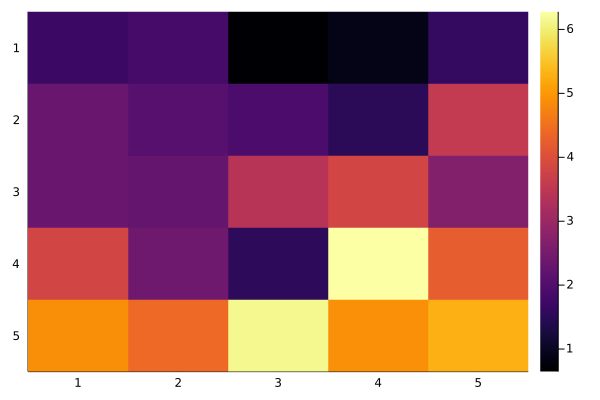

In [53]:
heatmap(data',yflip=true)

In [54]:
mean.(data)

5×5 Matrix{Float64}:
 1.67911   2.29734  2.31109  3.81243  4.88286
 1.82841   2.06495  2.2372   2.39274  4.39875
 0.646993  1.89098  3.39748  1.51921  6.14228
 0.865146  1.48579  3.81163  6.27623  4.91138
 1.58662   3.57433  2.65365  4.21969  5.27947

In [56]:
mean(data,dims=1)

1×5 Matrix{Float64}:
 1.32126  2.26268  2.88221  3.64406  5.12295

In [57]:
mean(data,dims=1) #better!

1×5 Matrix{Float64}:
 1.32126  2.26268  2.88221  3.64406  5.12295

In [58]:
data = Dict()
data[:cats] = rand(Normal(2.3,1),5)
data["dogs"] = rand(Normal(5.2,1),5)
data[25] = rand(Normal(7.8,1),5)
data

Dict{Any, Any} with 3 entries:
  "dogs" => [6.62305, 5.60839, 5.78862, 4.90372, 5.89111]
  25     => [8.30687, 7.74307, 6.02898, 9.39062, 9.19706]
  :cats  => [2.41142, 1.94212, 2.77371, 2.60023, 1.53732]

In [59]:
[(i+1)^2 for i in 1:5]

5-element Vector{Int64}:
  4
  9
 16
 25
 36

In [60]:
keys(data)

KeySet for a Dict{Any, Any} with 3 entries. Keys:
  "dogs"
  25
  :cats

In [61]:
methods(my_mean)

# 3 methods for generic function "my_mean":
[1] my_mean(data::Vector{Float64}) in Main at In[35]:1
[2] my_mean(data::Vector{T}) where T in Main at In[41]:1
[3] my_mean(data) in Main at In[28]:1

In [63]:
data = Dict()
data[:cats] = rand(Normal(2.3,1),5)
data["dogs"] = rand(Normal(5.2,1),5)
data[25] = rand(Normal(7.8,1),5)
data

Dict{Any, Any} with 3 entries:
  "dogs" => [5.01458, 6.46972, 5.0375, 5.13281, 5.77728]
  25     => [8.69132, 5.50551, 6.62697, 6.92008, 7.30596]
  :cats  => [2.78156, 1.97806, 2.54634, 2.12121, 0.822119]

In [64]:
fix_seed!()
rn() = rand(Normal())
data = (rn(), rn(),rn())

(0.6791074260357777, 0.8284134829000359, -0.3530074003005963)

In [65]:
struct Person
    weight::Float64
    height::Float64
end

In [66]:
someone = Person(102, 180)

Person(102.0, 180.0)

In [67]:
someone.weight = 103 #Structs are immutable unless you state immutable

LoadError: setfield! immutable struct of type Person cannot be changed

In [68]:
me = Person(102, 180)
you = Person(83, 170)
me + you #can't add persons just like that

LoadError: MethodError: no method matching +(::Person, ::Person)
[0mClosest candidates are:
[0m  +(::Any, ::Any, [91m::Any[39m, [91m::Any...[39m) at operators.jl:560
[0m  +([91m::P[39m, ::T) where {T, X, P<:Polynomials.ChebyshevT{T, X}} at /home/banach/.julia/packages/Polynomials/Mu4EN/src/polynomials/ChebyshevT.jl:219
[0m  +([91m::T[39m, ::Any) where T<:Intervals.Interval at /home/banach/.julia/packages/Intervals/ua9cq/src/interval.jl:294
[0m  ...

In [69]:
import Base: + 

function +(x::Person, y::Person)
    Person(x.weight + y.weight, x.height + y.height)
end

+ (generic function with 472 methods)

In [70]:
me + you #Now you can

Person(185.0, 350.0)

In [71]:
import Base: /
function /(x::Person, n::Real)
    Person(x.weight/n, x.height/n)
end

/ (generic function with 209 methods)

In [72]:
mean([me,you]) #With + and / (by number) we can compute the mean of persons

Person(92.5, 175.0)

In [73]:
df = CSV.File("./data/temperatures.csv") |> DataFrame

,Year,Month,Day,Brisbane,GoldCoast
,Int64,Int64,Int64,Float64,Float64
1,2015,1,1,31.3,30.9
2,2015,1,2,30.5,30.1
3,2015,1,3,28.9,30.1
4,2015,1,4,30.2,30.1
5,2015,1,5,28.1,28.0
6,2015,1,6,29.5,29.3
7,2015,1,7,27.1,26.4
8,2015,1,8,28.4,27.7
9,2015,1,9,29.5,29.6


In [74]:
data = df.GoldCoast
mean(data)

26.163835263835264

In [75]:
println("Sample Mean: ", mean(data))
println("Harmonic ≤ Geometric ≤ Arithmetic ",      #\le + [TAB]
            (harmmean(data), geomean(data), mean(data)))

println("Sample Variance: ",var(data))
println("Sample Standard Deviation: ",std(data))
println("Minimum: ", minimum(data))
println("Maximum: ", maximum(data))
println("Median: ", median(data))
println("95th percentile: ", percentile(data, 95))
println("0.95 quantile: ", quantile(data, 0.95))
println("Interquartile range: ", iqr(data),"\n")

summarystats(data)

Sample Mean: 26.163835263835264
Harmonic ≤ Geometric ≤ Arithmetic (25.65423319190783, 25.915563409789065, 26.163835263835264)
Sample Variance: 12.367253570765161
Sample Standard Deviation: 3.516710618001595
Minimum: 15.4
Maximum: 36.5
Median: 26.8
95th percentile: 30.9
0.95 quantile: 30.9
Interquartile range: 5.5



Summary Stats:
Length:         777
Missing Count:  0
Mean:           26.163835
Minimum:        15.400000
1st Quartile:   23.400000
Median:         26.800000
3rd Quartile:   28.900000
Maximum:        36.500000


In [76]:
min(5,2,-3) #Minimum of individual function arguments

-3

In [77]:
minimum([5,2,-3]) #Minimum of an array (AbstractArray)

-3

In [78]:
fix_seed!()
data = rand(Normal(),10^6);

In [79]:
@time begin
    minimum(data)
end

  0.000984 seconds (1 allocation: 16 bytes)


-4.846415885152558

In [80]:
@time begin
    min(data...)
end

  0.767338 seconds (2.10 M allocations: 82.024 MiB, 17.66% gc time, 8.50% compilation time)


-4.846415885152558

In [81]:
fix_seed!()

function montyHall(switch_policy)
    prize, choice = rand(1:3), rand(1:3)
    if prize == choice
        revealed = rand(setdiff(1:3,choice))
    else
        revealed = rand(setdiff(1:3,[prize,choice]))
    end

    if switch_policy
        choice = setdiff(1:3,[revealed,choice])[1]
    end
    return choice == prize
end

N = 10^6
println("Success probability with policy I (stay): ",  sum([montyHall(false) for _ in 1:N])/N)
println("Success probability with policy II (switch): ", sum([montyHall(true) for _ in 1:N])/N)

Success probability with policy I (stay): 0.334146
Success probability with policy II (switch): 0.666056


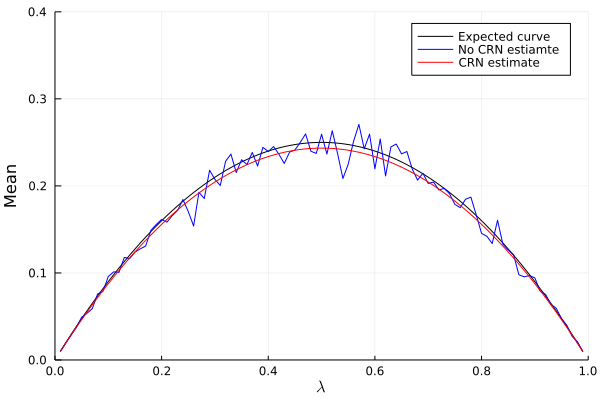

In [82]:
seed = 1
N = 100
λ_grid = 0.01:0.01:0.99

theorM(λ) = mean(Uniform(0,2λ*(1-λ)))
estM(λ) = mean(rand(Uniform(0,2λ*(1-λ)),N))

function estM(λ, seed)
    Random.seed!(seed)
    estM(λ)
end

trueM = theorM.(λ_grid)
estM0 = estM.(λ_grid)
estMCRN = estM.(λ_grid,seed)

plot(λ_grid, trueM, c=:black, label="Expected curve")
plot!(λ_grid, estM0, c=:blue, label="No CRN estiamte")
plot!(λ_grid, estMCRN, c=:red, label="CRN estimate", 
    xlims=(0,1), ylims=(0,0.4), xlabel=L"\lambda", ylabel = "Mean")

In [ ]:
α β δ γ θ

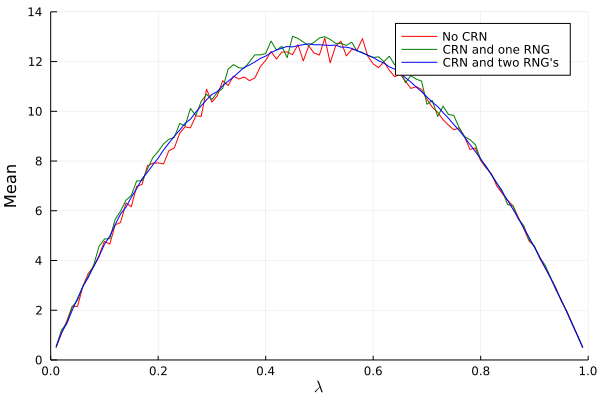

In [83]:
K = 50

prn(λ,rng) = quantile(Poisson(λ),rand(rng))
zDist(λ) = Uniform(0,2*(1-λ))

rv(λ,rng) = sum([rand(rng,zDist(λ)) for _ in 1:prn(K*λ, rng)])
rv2(λ,rng1,rng2) = sum([rand(rng1,zDist(λ)) for _ in 1:prn(K*λ,rng2)])

mEst(λ,rng) = mean([rv(λ,rng) for _ in 1:N])
mEst2(λ,rng1,rng2) = mean([rv2(λ,rng1,rng2) for _ in 1:N])

#No Common Random Numbers (CRN)
function mGraph0(seed)
    singleRng = MersenneTwister(seed)
    [mEst(λ,singleRng) for λ in λ_grid]
end

#CRN but single random number generator (RNG)
mGraph1(seed) = [mEst(λ,MersenneTwister(seed)) for λ in λ_grid]

#CRN with two random number generators
mGraph2(seed1,seed2) = [mEst2(λ,MersenneTwister(seed1), MersenneTwister(seed2)) for λ in λ_grid]

plot(λ_grid,mGraph0(1987), c=:red, label="No CRN")
plot!(λ_grid,mGraph1(1987), c=:green, label="CRN and one RNG")
plot!(λ_grid,mGraph2(1987,1988), c=:blue, label="CRN and two RNG's", xlims=(0,1),ylims=(0,14),
    xlabel=L"\lambda", ylabel = "Mean")


In [84]:
argMaxλ(graph) = λ_grid[findmax(graph)[2]]

M = 10^3
std0 = std([argMaxλ(mGraph0(seed)) for seed in 1:M])
std1 = std([argMaxλ(mGraph1(seed)) for seed in 1:M])
std2 = std([argMaxλ(mGraph2(seed,seed+M)) for seed in 1:M])

println("Standard deviation with no CRN: ", std0)
println("Standard deviation with CRN and single RNG: ", std1)
println("Standard deviation with CRN and two RNGs: ", std2)

Standard deviation with no CRN: 0.03708052002015299
Standard deviation with CRN and single RNG: 0.03411444555309959
Standard deviation with CRN and two RNGs: 0.014645353747396703


In [85]:
using RCall

data1 = DataFrame(CSV.File("./data/machine1.csv", header=false))[:,1]
data2 = DataFrame(CSV.File("./data/machine2.csv", header=false))[:,1]
data3 = DataFrame(CSV.File("./data/machine3.csv", header=false))[:,1]

function R_ANOVA(allData)
    data = vcat([ [x fill(i, length(x))] for (i, x) in enumerate(allData) ]...)
    df = DataFrame(data, [:Diameter, :MachNo])
    @rput df

    R"""
    df$MachNo <- as.factor(df$MachNo)
    anova <- summary(aov( Diameter ~ MachNo, data=df))
    fVal <- anova[[1]]["F value"][[1]][1]
    pVal <- anova[[1]]["Pr(>F)"][[1]][1]
    """
    println("R ANOVA f-value: ", @rget fVal)
    println("R ANOVA p-value: ", @rget pVal)
end

R_ANOVA([data1, data2, data3])

LoadError: ArgumentError: Package RCall not found in current path:
- Run `import Pkg; Pkg.add("RCall")` to install the RCall package.


In [86]:
import Pkg; Pkg.add("RCall")

    Updating registry at `~/.julia/registries/General`
    Updating git-repo `https://github.com/JuliaRegistries/General.git`
   Resolving package versions...
   Installed WinReg ─ v0.3.1
   Installed RCall ── v0.13.12
    Updating `~/ws/JuliaCon2021-StatisticsWithJuliaFromTheGroundUp/Project.toml`
  [6f49c342] + RCall v0.13.12
    Updating `~/ws/JuliaCon2021-StatisticsWithJuliaFromTheGroundUp/Manifest.toml`
  [8f4d0f93] + Conda v1.5.2
  [6f49c342] + RCall v0.13.12
  [81def892] + VersionParsing v1.2.0
  [1b915085] + WinReg v0.3.1
    Building RCall → `~/.julia/scratchspaces/44cfe95a-1eb2-52ea-b672-e2afdf69b78f/80a056277142a340e646beea0e213f9aecb99caa/build.log`


LoadError: Error building `RCall`: 
ERROR: LoadError: R_HOME is not a directory.
Stacktrace:
 [1] error(s::String)
   @ Base ./error.jl:33
 [2] top-level scope
   @ ~/.julia/packages/RCall/iMDW2/deps/build.jl:53
 [3] include(fname::String)
   @ Base.MainInclude ./client.jl:444
 [4] top-level scope
   @ none:5
in expression starting at /home/banach/.julia/packages/RCall/iMDW2/deps/build.jl:11

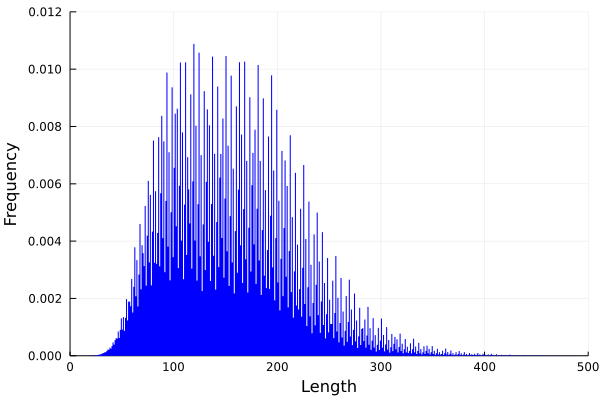

In [87]:
function hailLength(x::Int)
    n = 0
    while x != 1
        if x % 2 == 0
            x = x ÷ 2 #\div + [TAB]
        else
            x = 3x +1
        end
        n += 1
    end
    return n
end

lengths = [hailLength(x₀) for x₀ in 2:10^7] #\_0 + [TAB]

histogram(lengths, bins=1000, normed=:true, 
    fill=(:blue, true), la=0, legend=:none,
    xlims=(0, 500), ylims=(0, 0.012),
    xlabel="Length", ylabel="Frequency")

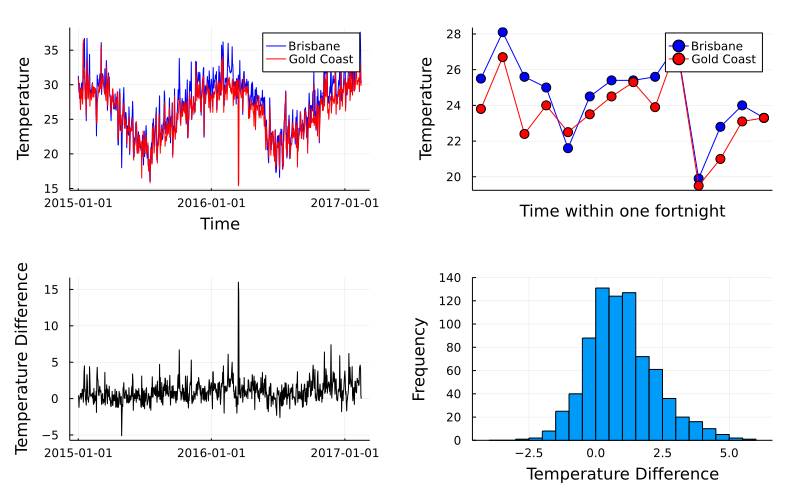

In [88]:
data = CSV.File("./data/temperatures.csv") |> DataFrame
brisbane = data.Brisbane
goldcoast = data.GoldCoast

diff = brisbane - goldcoast
dates = [Date(
            Year(data.Year[i]), 
            Month(data.Month[i]), 
            Day(data.Day[i])
        ) for i in 1:nrow(data)]

fortnightRange = 250:263
brisFortnight = brisbane[fortnightRange]
goldFortnight = goldcoast[fortnightRange]

p1 = plot(dates, [brisbane goldcoast], 
        c=[:blue :red], xlabel="Time", ylabel="Temperature", label=["Brisbane" "Gold Coast"])
p2 = plot(dates[fortnightRange], [brisFortnight goldFortnight], xticks=:none,
        c=[:blue :red], m=(:dot, 5, Plots.stroke(1)), ylabel="Temperature",
        label=["Brisbane" "Gold Coast"], xlabel="Time within one fortnight")
p3 = plot(dates, diff, 
        c=:black, ylabel="Temperature Difference",legend=false)
p4 = histogram(diff, bins=-4:0.5:6, 
        ylims=(0,140), legend = false,
        xlabel="Temperature Difference", ylabel="Frequency")
plot(p1,p2,p3,p4, size = (800,500), margin = 5mm)

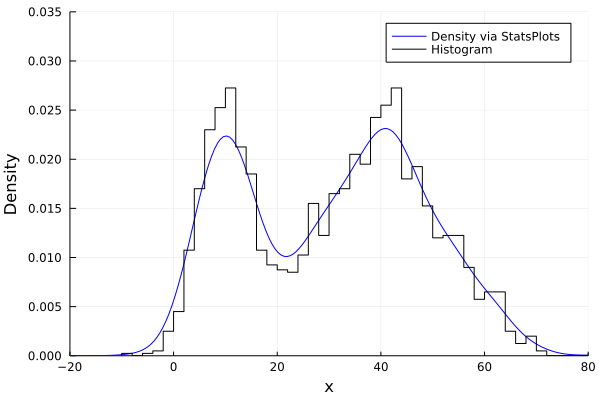

In [89]:
fix_seed!()

μ₁, σ₁ = 10, 5 #\mu + [TAB] \_1 + [TAB] etc...
μ₂, σ₂ = 40, 12
dist1, dist2 = Normal(μ₁,σ₁), Normal(μ₂,σ₂)
p = 0.3
mixRv() = (rand() <= p) ? rand(dist1) : rand(dist2)

n = 2000
data = [mixRv() for _ in 1:n]

density(data, c=:blue, label="Density via StatsPlots", xlims=(-20,80), ylims=(0,0.035))
stephist!(data, bins=50, c=:black, norm=true, label="Histogram", xlabel="x", ylabel = "Density")

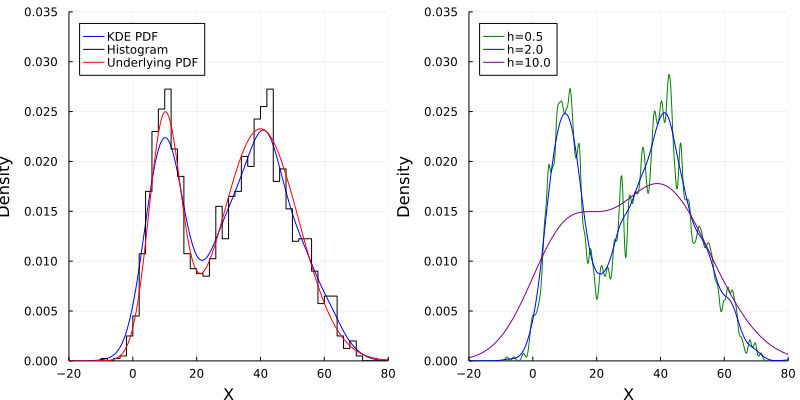

In [90]:
mixPDF(x) = p*pdf(dist1,x) + (1-p)*pdf(dist2,x)

kdeDist = kde(data)

xGrid = -20:0.1:80
pdfKDE = pdf(kdeDist,xGrid)

p1 = plot(xGrid, pdfKDE, c=:blue, label="KDE PDF")
stephist!(data, bins=50, c=:black, normed=:true, label="Histogram")
plot!(xGrid, mixPDF.(xGrid), c=:red, label="Underlying PDF",
    xlims=(-20,80), ylims=(0,0.035), legend=:topleft,
    xlabel="X", ylabel = "Density")

hVals = [0.5,2,10]
kdeS = [kde(data,bandwidth=h) for h in hVals]

p2 = plot(xGrid, pdf(kdeS[1],xGrid), c = :green, label= "h=$(hVals[1])")
plot!(xGrid, pdf(kdeS[2],xGrid), c = :blue, label= "h=$(hVals[2])")
plot!(xGrid, pdf(kdeS[3],xGrid), c = :purple, label= "h=$(hVals[3])",
    xlims=(-20,80), ylims=(0,0.035), legend=:topleft, 
    xlabel="X", ylabel = "Density")

plot(p1,p2,size = (800,400))

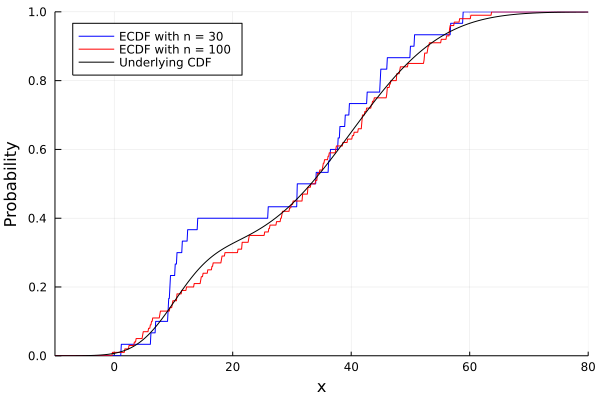

In [91]:
fix_seed!()

mixCDF(x) = p*cdf(dist1,x) + (1-p)*cdf(dist2,x)

n = [30, 100]
data1 = [mixRv() for _ in 1:n[1]]
data2 = [mixRv() for _ in 1:n[2]]

empiricalCDF1 = ecdf(data1)
empiricalCDF2 = ecdf(data2)

xGrid = -10:0.1:80
plot(xGrid,empiricalCDF1.(xGrid), c=:blue, label="ECDF with n = $(n[1])")
plot!(xGrid,empiricalCDF2.(xGrid), c=:red, label="ECDF with n = $(n[2])")
plot!(xGrid, mixCDF.(xGrid), c=:black, label="Underlying CDF",
    xlims=(-10,80), ylims=(0,1), 
    xlabel="x", ylabel="Probability", legend=:topleft)

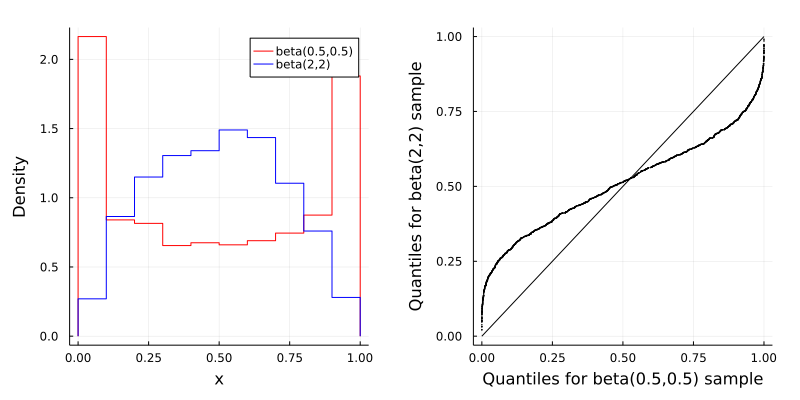

In [92]:
fix_seed!()

b1, b2 = 0.5 , 2
dist1, dist2, = Beta(b1,b1), Beta(b2,b2)
 
n = 2000
data1 = rand(dist1,n)
data2 = rand(dist2,n)

stephist(data1, bins=15, label = "beta($b1,$b1)", c = :red, normed = true)
p1 = stephist!(data2, bins=15, label = "beta($b2,$b2)",
        c = :blue, xlabel="x", ylabel="Density",normed = true)

p2 = qqplot(data1, data2, c=:black, ms=1, msw =0,
        xlabel="Quantiles for beta($b1,$b1) sample",
        ylabel="Quantiles for beta($b2,$b2) sample",
        legend=false)

plot(p1, p2, size=(800,400), margin = 5mm)

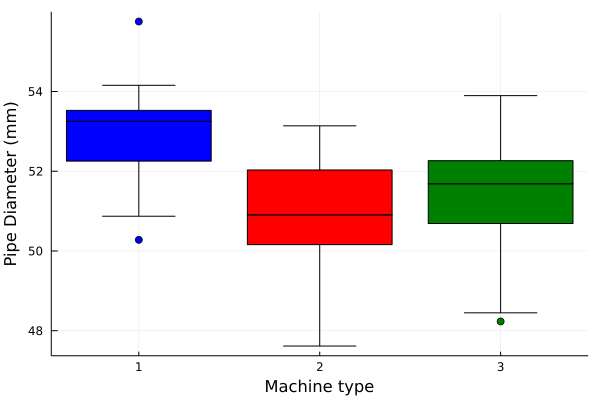

In [93]:
data1 = parse.(Float64, readlines("./data/machine1.csv"))
data2 = parse.(Float64, readlines("./data/machine2.csv"))
data3 = parse.(Float64, readlines("./data/machine3.csv"))

boxplot([data1,data2,data3], c=[:blue :red :green], label="", 
    xticks=([1:1:3;], ["1", "2", "3"]), xlabel="Machine type",
    ylabel="Pipe Diameter (mm)")

In [94]:
dist = Normal(2.5,1.2)

Normal{Float64}(μ=2.5, σ=1.2)

In [95]:
mean(dist), var(dist)

(2.5, 1.44)

In [96]:
fix_seed!()
rand(dist,3,2,5) #a 3-tensor

3×2×5 Array{Float64, 3}:
[:, :, 1] =
 3.31493  2.33818
 3.4941   3.20394
 2.07639  2.8568

[:, :, 2] =
 2.57794  4.3892
 2.36918  1.67331
 1.88295  1.58464

[:, :, 3] =
 2.97698   2.27491
 3.47396   0.571292
 2.08437  -0.476951

[:, :, 4] =
 5.23148  1.7785
 2.76363  3.87073
 2.35943  2.39366

[:, :, 5] =
 2.83536  3.06846
 2.63371  2.86028
 2.07054  1.58479

In [97]:
? NegativeBinomial

search: NegativeBinomial NegativeBinomialLink



```
NegativeBinomial(r,p)
```

A *Negative binomial distribution* describes the number of failures before the `r`th success in a sequence of independent Bernoulli trials. It is parameterized by `r`, the number of successes, and `p`, the probability of success in an individual trial.

$$
P(X = k) = {k + r - 1 \choose k} p^r (1 - p)^k, \quad \text{for } k = 0,1,2,\ldots.
$$

The distribution remains well-defined for any positive `r`, in which case

$$
P(X = k) = \frac{\Gamma(k+r)}{k! \Gamma(r)} p^r (1 - p)^k, \quad \text{for } k = 0,1,2,\ldots.
$$

```julia
NegativeBinomial()        # Negative binomial distribution with r = 1 and p = 0.5
NegativeBinomial(r, p)    # Negative binomial distribution with r successes and success rate p

params(d)       # Get the parameters, i.e. (r, p)
succprob(d)     # Get the success rate, i.e. p
failprob(d)     # Get the failure rate, i.e. 1 - p
```

External links:

  * [Negative binomial distribution on Wolfram](https://reference.wolfram.com/language/ref/NegativeBinomialDistribution.html)

Note: The definition of the negative binomial distribution in Wolfram is different from the [Wikipedia definition](http://en.wikipedia.org/wiki/Negative_binomial_distribution). In Wikipedia, `r` is the number of failures and `k` is the number of successes.


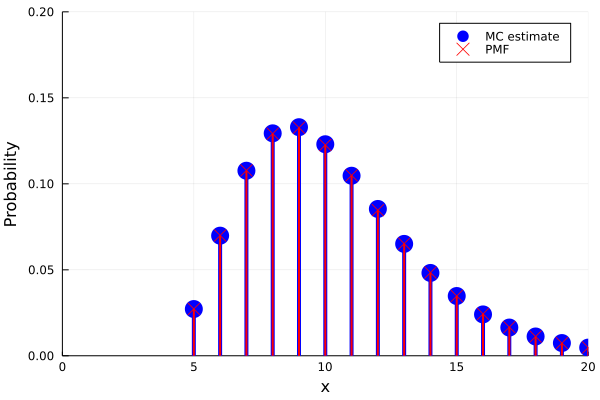

In [98]:
fix_seed!()

function rouletteSpins(r,p)
    x = 0
    wins = 0
    while true
        x += 1
        if rand() < p
            wins += 1
            if wins == r
                return x
            end
        end
    end
end

r, p, N = 5, 18/37,10^6
xGrid = r:r+15

mcEstimate = counts([rouletteSpins(r,p) for _ in 1:N],xGrid)/N

nbDist = NegativeBinomial(r,p)
nbPmf = [pdf(nbDist,x-r) for x in xGrid]

plot( xGrid, mcEstimate, 
    line=:stem, marker=:circle, c=:blue, 
    ms=10, msw=0, lw=4, label="MC estimate")
plot!( xGrid, nbPmf, line=:stem, 
    marker=:xcross, c=:red, ms=6, msw=0, lw=2, label="PMF", 
    xlims=(0,maximum(xGrid)), ylims=(0,0.2), 
    xlabel="x", ylabel="Probability")

┌ Info: Saved animation to 
│   fn = /home/banach/ws/JuliaCon2021-StatisticsWithJuliaFromTheGroundUp/sample_animation.gif
└ @ Plots /home/banach/.julia/packages/Plots/S2aH5/src/animation.jl:104


Plots.AnimatedGif("/home/banach/ws/JuliaCon2021-StatisticsWithJuliaFromTheGroundUp/sample_animation.gif")
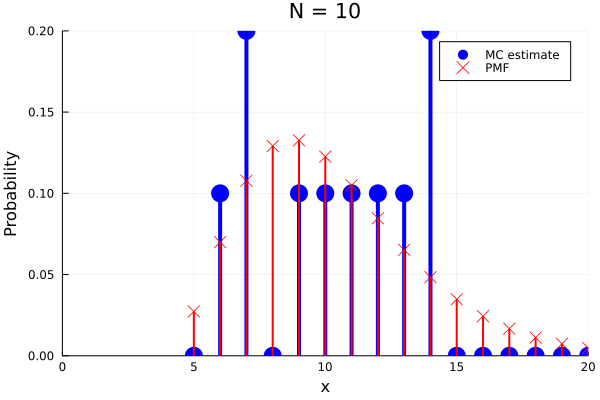

In [99]:
function plot_it(N)
    fix_seed!()
    mcEstimate = counts([rouletteSpins(r,p) for _ in 1:N],xGrid)/N

    nbDist = NegativeBinomial(r,p)
    nbPmf = [pdf(nbDist,x-r) for x in xGrid]

    plot( xGrid, mcEstimate, 
        line=:stem, marker=:circle, c=:blue, 
        ms=10, msw=0, lw=4, label="MC estimate")
    plot!( xGrid, nbPmf, line=:stem, 
        marker=:xcross, c=:red, ms=6, msw=0, lw=2, label="PMF", 
        xlims=(0,maximum(xGrid)), ylims=(0,0.2), 
        xlabel="x", ylabel="Probability",
        title="N = $N")
end

anim = Animation()

for N in union(10:10:100,200:100,1000,2000:1000:10^4)
    plot_it(N)
    frame(anim)
end

gif(anim,"sample_animation.gif",fps = 3)

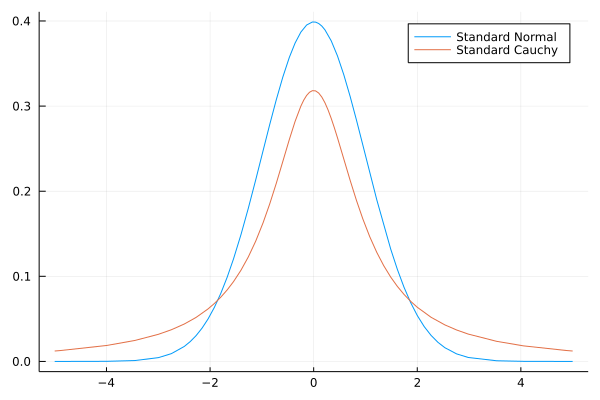

In [100]:
plot((x)->pdf(Normal(),x),label = "Standard Normal")
plot!((x)->pdf(Cauchy(),x),label = "Standard Cauchy")

In [101]:
fix_seed!()

n = 10^6
data = rand(Normal(), n)
#data = rand(Cauchy(),n) #Try this instead
averages = accumulate(+,data) ./ (1:n)

plot( 1:n, averages, 
    c=:blue, legend=:none, xscale=:log10, xlims=(1,n), xlabel="n", ylabel="Running average")

In [102]:
fix_seed!()

N = 10^4

Σ = [ 6 4 ;
         4 9]
μ = [15 ; 
       20]
A = cholesky(Σ).L

rngGens = [()->rand(Normal()), 
           ()->rand(Uniform(-sqrt(3),sqrt(3))),
           ()->rand(Exponential())-1]

rv(rg) = A*[rg(),rg()] + μ
    
data = [[rv(r) for _ in 1:N] for r in rngGens]

stats(data) = begin
    data1, data2 = first.(data),last.(data)
    println(round(mean(data1),digits=2), "\t",round(mean(data2),digits=2),"\t",
            round(var(data1),digits=2), "\t", round(var(data2),digits=2), "\t",
            round(cov(data1,data2),digits=2))
end

println("Mean1\tMean2\tVar1\tVar2\tCov")
for d in data
    stats(d)
end

scatter(first.(data[1]), last.(data[1]), c=:blue, ms=1, msw=0, label="Normal")
scatter!(first.(data[2]), last.(data[2]), c=:red, ms=1, msw=0, label="Uniform")
scatter!(first.(data[3]), last.(data[3]), c=:green, ms=1, msw=0,label="Exponential",
    xlims=(0,40), ylims=(0,40), legend=:bottomright, ratio=:equal,
    xlabel=L"X_1", ylabel=L"X_2")

Mean1	Mean2	Var1	Var2	Cov
15.03	20.0	6.07	8.98	4.08
15.01	19.97	6.08	9.09	4.05
15.01	20.0	6.02	9.28	4.04


In [103]:
dist = MvNormal([1,1],[2 2.3; 2.3 4])

FullNormal(
dim: 2
μ: [1.0, 1.0]
Σ: [2.0 2.3; 2.3 4.0]
)


In [104]:
cor(dist)

2×2 Matrix{Float64}:
 1.0       0.813173
 0.813173  1.0

In [105]:
rand(dist,20)

2×20 Matrix{Float64}:
 -1.14987  -0.000710292  0.734429  …  1.78702  2.84194  2.41636  1.19628
 -1.87928   0.0846214    1.79441      1.42384  4.54479  3.26142  1.58829

In [106]:
ENV["LINES"] = 10
data = CSV.File("./data/purchaseData.csv") |> DataFrame

,Name,Date,Grade,Price
,String?,String?,String?,Int64?
1,MARYANNA,14/09/2008,A,79700
2,REBECCA,11/03/2008,B,missing
3,ASHELY,5/08/2008,E,24311
4,KHADIJAH,2/09/2008,missing,38904
5,TANJA,1/12/2008,C,47052
6,JUDIE,17/05/2008,D,34365
7,NOE,15/08/2008,A,79344
8,JACALYN,7/10/2008,E,21474
9,SANDY,5/04/2008,D,missing


In [107]:
size(data)

(200, 4)

In [108]:
names(data)

4-element Vector{String}:
 "Name"
 "Date"
 "Grade"
 "Price"

In [109]:
first(data, 6)

,Name,Date,Grade,Price
,String?,String?,String?,Int64?
1,MARYANNA,14/09/2008,A,79700
2,REBECCA,11/03/2008,B,missing
3,ASHELY,5/08/2008,E,24311
4,KHADIJAH,2/09/2008,missing,38904
5,TANJA,1/12/2008,C,47052
6,JUDIE,17/05/2008,D,34365


In [110]:
describe(data)

,variable,mean,min,median,max,nmissing,eltype
,Symbol,Union…,Any,Union…,Any,Int64,Union
1,Name,,ABBEY,,ZACHARY,17,"Union{Missing, String}"
2,Date,,1/07/2008,,9/10/2008,4,"Union{Missing, String}"
3,Grade,,A,,E,13,"Union{Missing, String}"
4,Price,39702.0,8257,38045.5,79893,14,"Union{Missing, Int64}"


In [111]:
println("Grade of person 1: ", data[1, 3], 
        ", ", data[1,:Grade], 
        ", ", data.Grade[1])

Grade of person 1: A, A, A


In [112]:
data[[1,2,4], :]

,Name,Date,Grade,Price
,String?,String?,String?,Int64?
1,MARYANNA,14/09/2008,A,79700
2,REBECCA,11/03/2008,B,missing
3,KHADIJAH,2/09/2008,missing,38904


In [113]:
data[13:15, :Name]

3-element Vector{Union{Missing, String}}:
 "SAMMIE"
 missing
 "STACEY"

In [114]:
data.Name[13:15]

3-element Vector{Union{Missing, String}}:
 "SAMMIE"
 missing
 "STACEY"

In [115]:
data[13:15, [:Name]]

,Name
,String?
1,SAMMIE
2,missing
3,STACEY


In [116]:
mean(data.Price)

missing

In [117]:
ismissing.(data.Price) |> sum

14

In [118]:
mean(skipmissing(data.Price))

39702.01075268817

In [119]:
data.Grade[1:4]

4-element PooledArrays.PooledVector{Union{Missing, String}, UInt32, Vector{UInt32}}:
 "A"
 "B"
 "E"
 missing

In [120]:
coalesce.(data.Grade, "QQ")[1:4]

4-element Vector{String}:
 "A"
 "B"
 "E"
 "QQ"

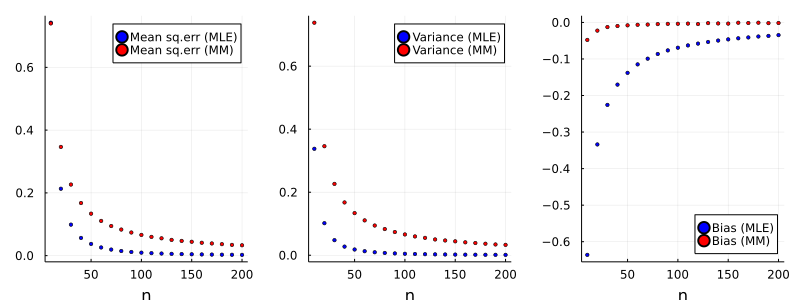

In [121]:
fix_seed!()

N = 10^5
nMin, nStep, nMax = 10, 10, 200
nn = Int(nMax/nStep)
sampleSizes = nMin:nStep:nMax
trueB = 5
trueDist = Uniform(-2, trueB)

#MLE for the upper bound
MLEest(data) = maximum(data)

#Method of moments estimator for the upper bound
MMest(data)  = mean(data) + sqrt(3)*std(data)

res = Dict{Symbol,Array{Float64}}( ((sym) -> sym => Array{Float64}(undef,nn)).(
                                [:MSeMLE,:MSeMM, :VarMLE,:VarMM,:BiasMLE,:BiasMM]))

for (i, n) in enumerate(sampleSizes)
    mleEst, mmEst = Array{Float64}(undef, N), Array{Float64}(undef, N) 
    for j in 1:N
        sample    = rand(trueDist,n)
        mleEst[j] = MLEest(sample)
        mmEst[j]  = MMest(sample)
    end
    meanMLE, meanMM = mean(mleEst), mean(mmEst)
    varMLE, varMM = var(mleEst), var(mmEst)

    res[:MSeMLE][i] = varMLE + (meanMLE - trueB)^2
    res[:MSeMM][i] = varMM + (meanMM - trueB)^2
    res[:VarMLE][i] = varMLE
    res[:VarMM][i] = varMM
    res[:BiasMLE][i] = meanMLE - trueB
    res[:BiasMM][i] = meanMM - trueB
end

p1 = scatter(sampleSizes, [res[:MSeMLE] res[:MSeMM]], c=[:blue :red],
    label=["Mean sq.err (MLE)" "Mean sq.err (MM)"])
p2 = scatter(sampleSizes, [res[:VarMLE] res[:VarMM]], c=[:blue :red],
    label=["Variance (MLE)" "Variance (MM)"])
p3 = scatter(sampleSizes, [res[:BiasMLE] res[:BiasMM]], c=[:blue :red],
    label=["Bias (MLE)" "Bias (MM)"],legend = :bottomright)

plot(p1, p2, p3, ms=2, shape=:circle, xlabel="n", 
    layout=(1,3), size=(800, 300), margin = 2mm)

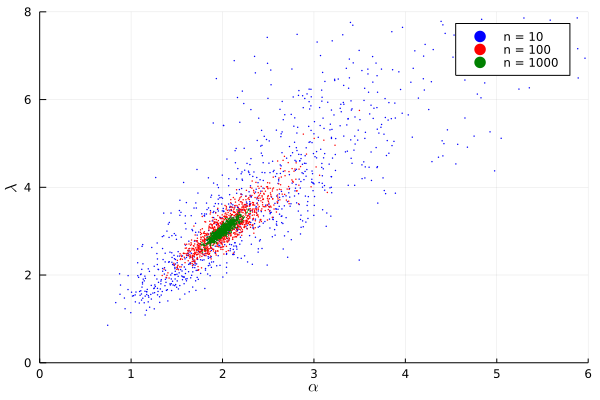

In [122]:
fix_seed!()

eq(alpha, xb, xbl) = log(alpha) - digamma(alpha) - log(xb) + xbl

actualAlpha, actualLambda = 2, 3
gammaDist = Gamma(actualAlpha,1/actualLambda)

function mle(sample)
    alpha  = find_zero( (a)->eq(a,mean(sample),mean(log.(sample))), 1)
    lambda = alpha/mean(sample)
    return [alpha,lambda]
end

N = 10^3

mles10   = [mle(rand(gammaDist,10)) for _ in 1:N]
mles100  = [mle(rand(gammaDist,100)) for _ in 1:N]
mles1000 = [mle(rand(gammaDist,1000)) for _ in 1:N]

scatter(first.(mles10), last.(mles10), 
    c=:blue, ms=1, msw=0, label="n = 10")
scatter!(first.(mles100), last.(mles100), 
    c=:red, ms=1, msw=0, label="n = 100")
scatter!(first.(mles1000), last.(mles1000), 
    c=:green, ms=1, msw=0, label="n = 1000", 
    xlims=(0,6), ylims=(0,8), xlabel=L"\alpha", ylabel=L"\lambda")

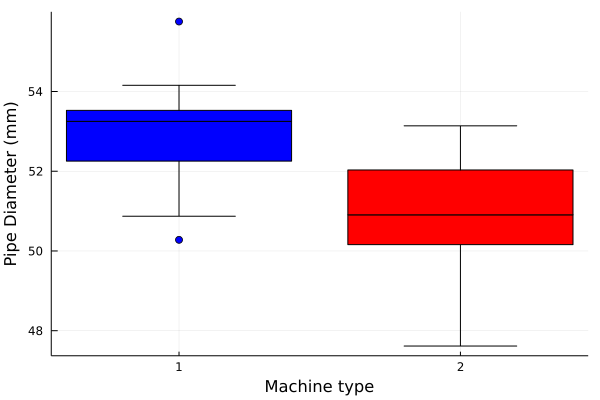

In [123]:
data1 = (CSV.File("./data/machine1.csv", header=false) |> DataFrame)[:,1]
data2 = (CSV.File("./data/machine2.csv", header=false) |> DataFrame)[:,1]
boxplot([data1,data2], c=[:blue :red], label="", 
    xticks=([1:2;], ["1", "2"]), xlabel="Machine type",
    ylabel="Pipe Diameter (mm)")

In [124]:
α = 0.05 #\alpha + [TAB]
confint(EqualVarianceTTest(data1,data2),α)

(1.1127539574575822, 2.90486485574026)

In [125]:
#Doing it manually
xBar1, xBar2 = mean(data1), mean(data2)
n1, n2 = length(data1), length(data2)
t = quantile(TDist(n1+n2-2),1-α/2)

s1, s2 = std(data1), std(data2)
sP = sqrt(((n1-1)*s1^2 + (n2-1)*s2^2) / (n1+n2-2))

(xBar1 - xBar2 - t*sP* sqrt(1/n1 + 1/n2), xBar1 - xBar2 + t*sP* sqrt(1/n1 + 1/n2))

(1.1127539574575822, 2.90486485574026)